<p style="text-align:center"><img src=../images/header.png/></p>

<p style="text-align:center"><img src="https://camo.githubusercontent.com/4a300a0747dc7b5c69a83cc94ff2e2b5ad1f0f937ed3d142b171c0d4a6f8e164/68747470733a2f2f7777772e67652e636f6d2f72656e657761626c65656e657267792f73697465732f64656661756c742f66696c65732f323032302d30312f6f6e73686f72652d6865726f352e6a7067"/></p>


<h1 align="center">ARIMA - Modell</h1>

In [1]:
import pandas as pd
import numpy as np
%matplotlib notebook
#calling it a second time may prevent some graphics errors
%matplotlib notebook
from statsmodels.tsa.arima_model import ARIMA
import warnings
from sklearn.metrics import mean_squared_error
from math import sqrt
import matplotlib.pyplot as plt
#plt.style.use('publication') 
import warnings
warnings.filterwarnings("ignore")

#### Please fill in the path to the preprocessed data.

In [2]:
pre_path = "../data/preprocessed/measurement_windio_msb-0002-a_2021-10-21.csv"

#### Please fill in your desired resample frequency.
Y <==> Year <br>
Q <==> Quarter <br>
M <==> Month <br>
W <==> Week <br>
D <==> Day <br>
H <==> Hour <br>
T <==> Minute <br>
S <==> Second

In [3]:
res_freq = "10S"

#### The following cell shows your preprocessed input data.

In [4]:
from scipy import integrate
from scipy.signal import butter, lfilter, sosfiltfilt, filtfilt

def butter_highpass_sosfiltfilt(data, lowcut=0.1, fs=50, pad='even', padlen=500, order=9):
    """
    applies a symmetric filter (no phase offset)
    """

    if pad not in ('even', 'odd', 'constant', None):
        raise Exception('please provide a valid padding')

    # check if len(data > padlen)
    if len(data) < padlen:
        print(
            f'padlen exceeds the number of available data points. Setting padlen to {len(data)}')
        padlen = len(data) - 1

    nyq = fs*0.5
    low = lowcut/nyq

    sos = butter(order, low, btype='highpass', output='sos')
    y = sosfiltfilt(sos, data, padtype=pad, padlen=padlen)

    return y

df = pd.read_csv(pre_path, parse_dates=["date_time"], index_col="date_time")
df.drop(['uptime', 'mag_x', 'mag_y', 'mag_z', 'temp', 'rot_x', 'rot_y', 'rot_z', 'acc_z'], axis=1, inplace=True)
for c in ['acc_x', 'acc_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c])
#df["acc_x"] = df["acc_x"] - df["acc_x"].mean()
#df["acc_y"] = df["acc_y"] - df["acc_y"].mean()

t = df.index.astype('int64')/1e9
df = df.dropna()
for component in ['x', 'y']:
        df.insert(loc=len(df.columns),
                    value=integrate.cumtrapz(
                        df[f'acc_{component}'], t, initial=0),
                    column=f'vel_{component}',)

for c in ['vel_x', 'vel_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c], lowcut=0.5)
#df["vel_x"] = df["vel_x"] - df["vel_x"].mean()
#df["vel_y"] = df["vel_y"] - df["vel_y"].mean()
                    
for component in ['x', 'y']:
        df.insert(loc=len(df.columns),
                    value=integrate.cumtrapz(
                        df[f'vel_{component}'], t, initial=0),
                    column=f'pos_{component}',
                 )
for c in ['pos_x', 'pos_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c], lowcut=0.5)
#df["pos_x"] = df["pos_x"] - df["pos_x"].mean()
#df["pos_y"] = df["pos_y"] - df["pos_y"].mean()

df.head(10)

,acc_x,acc_y,vel_x,vel_y,pos_x,pos_y
date_time,,,,,,
2021-10-21 09:42:23.724786432,0.004309,-0.003059,-0.000330,0.000584,-0.000129,-0.000104
2021-10-21 09:42:23.744237312,0.002843,-0.002448,-0.000261,0.000530,-0.000135,-0.000093
2021-10-21 09:42:23.763693056,0.003453,0.000421,-0.000201,0.000511,-0.000139,-0.000083
2021-10-21 09:42:23.783293696,0.005772,-0.003913,-0.000113,0.000477,-0.000142,-0.000072
2021-10-21 09:42:23.802685440,0.005650,-0.000189,-0.000006,0.000438,-0.000142,-0.000063
2021-10-21 09:42:23.822234368,0.002903,-0.001776,0.000074,0.000420,-0.000140,-0.000054
2021-10-21 09:42:23.843896064,0.004307,-0.001044,0.000147,0.000391,-0.000137,-0.000044
2021-10-21 09:42:23.861061888,0.005528,0.000788,0.000225,0.000390,-0.000132,-0.000036
2021-10-21 09:42:23.880558592,0.006078,-0.004766,0.000331,0.000353,-0.000125,-0.000027


#### Removes the columns that are not needed and all empty values.

In [5]:
df.describe()

,acc_x,acc_y,vel_x,vel_y,pos_x,pos_y
count,1.781780e+05,1.781780e+05,1.781780e+05,1.781780e+05,1.781780e+05,1.781780e+05
mean,-1.529358e-07,8.622056e-08,-1.916490e-09,1.171717e-09,-5.326910e-10,-4.192048e-10
std,2.370694e-02,2.521701e-02,1.614766e-03,1.056252e-03,3.471553e-04,2.488307e-04
min,-8.379319e-02,-8.476630e-02,-1.196749e-01,-3.753220e-02,-4.205530e-02,-1.929501e-02
25%,-3.164391e-03,-1.897963e-03,-1.227222e-04,-8.547000e-05,-2.161261e-05,-1.422317e-05
50%,-3.928010e-05,-3.836701e-05,6.342084e-07,1.758674e-07,-2.193718e-08,-3.778362e-08
75%,3.053887e-03,1.791912e-03,1.224163e-04,8.553017e-05,2.154131e-05,1.436365e-05
max,3.990510e+00,3.991384e+00,1.218336e-01,3.771484e-02,1.161488e-02,1.196510e-02


In [6]:
df["acc_y"].mean()

8.622056274693336e-08

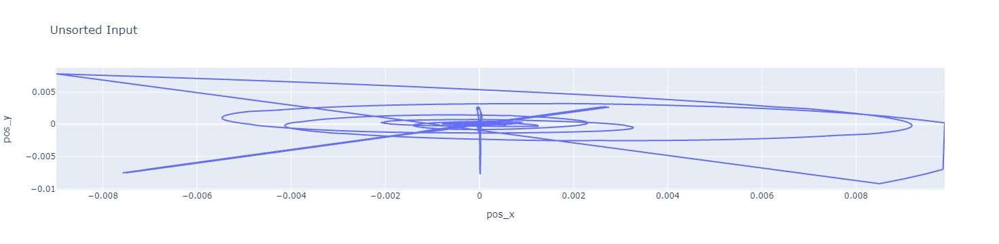

In [7]:
import plotly.express as px
df = df.iloc[:,:]
df = df[df["pos_x"]>-0.01]
df = df[df["pos_x"]<0.01]
df = df[df["pos_y"]<0.01]
df = df[df["pos_y"]>-0.01]
fig = px.line(df, x="pos_x", y="pos_y", title="Unsorted Input") 
fig.show()

#### Please fill in the column which should be forecasted.

In [8]:
col_forecast = "pos_x"

#### Plots the column which should be forecasted.

In [9]:
df[col_forecast].plot(ylabel=col_forecast, ylim=(-0.001, 0.001))

<IPython.core.display.Javascript object>

<AxesSubplot:xlabel='date_time', ylabel='pos_x'>

#### Devides the dataset into train and test data

In [10]:
train = df.iloc[:-(round(0.02*len(df)))]
test=df.iloc[-(round(0.02*len(df))):]

#### Trains the ARIMA Modell and calculates the preiction

In [11]:
model = ARIMA(train[col_forecast], order=(5,1,5))
model = model.fit()
pred=model.predict(start=len(train), end=len(train)+len(test)-1, typ="levels")
pred.index=df.index[len(train):len(train)+len(test)]

MemoryError: Unable to allocate 227. GiB for an array with shape (174500, 174500) and data type float64

#### Plots the testdata and ARIMA prediction

In [ ]:
pred.plot(title = "Testdata and ARIMA prediction", ylabel=col_forecast)
test[col_forecast].plot()

#### Calculates the RMSE value between testdata and prediction

In [ ]:
rmse = sqrt(mean_squared_error(pred, test[col_forecast]))
print(rmse)

#### Calculates the mean value of the testdata

In [ ]:
test[col_forecast].mean()

#### Plots the RMSE value between testdata and prediction for different time_intervals

In [ ]:
df2 = pd.DataFrame(data={'date_time': [0], 'rmse': [0]})
for i in range(1,110,1):    
    train = df.iloc[:-(round(0.001*i*len(df)))]
    test=df.iloc[-(round(0.001*i*len(df))):]
    model = ARIMA(train[col_forecast], order=(5,1,5))
    model = model.fit()
    pred=model.predict(start=len(train), end=len(train)+len(test)-1, typ="levels")
    pred.index=df.index[len(train):len(train)+len(test)]
    rmse = sqrt(mean_squared_error(pred, test[col_forecast]))
    df2 = df2.append({'date_time': len(test), 'rmse': rmse}, ignore_index=True)
df2["std"] = test[col_forecast].std()
df2.plot(legend=True, x="date_time", y=["rmse", "std"], title="RMSE over time")